## LightGBM-Ax　のサンプルコード（train, valid, test使用）

In [1]:
%load_ext lab_black

In [2]:
# ライブラリーのインポート
import os

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from ax.utils.notebook.plotting import init_notebook_plotting, render

%matplotlib inline

import warnings

# Ax
import ax

# LightGBM
import lightgbm as lgb
from ax import (
    ParameterType,
    RangeParameter,
    SearchSpace,
    SimpleExperiment,
    modelbridge,
    models,
)

# ボストンの住宅価格データ
from sklearn.datasets import load_boston

# 評価指標
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

# 前処理
from sklearn.preprocessing import StandardScaler

warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.simplefilter(
    action="ignore", category=pd.core.common.SettingWithCopyWarning
)

In [3]:
print(lgb.__version__)

3.1.1


In [4]:
print(ax.__version__)

0.2.0


In [5]:
# データセットの読込み
boston = load_boston()

# 説明変数の格納
df = pd.DataFrame(boston.data, columns=boston.feature_names)
# 目的変数の追加
df["MEDV"] = boston.target

# データの中身を確認
df.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33,36.2


#### 前処理

In [6]:
# ランダムシード値
RANDOM_STATE = 10

# 学習データと評価データの割合
TEST_SIZE = 0.2

# 学習データと評価データを作成
x_train, x_test, y_train, y_test = train_test_split(
    df.iloc[:, 0 : df.shape[1] - 1],
    df.iloc[:, df.shape[1] - 1],
    test_size=TEST_SIZE,
    random_state=RANDOM_STATE,
)

# trainのデータセットの2割をモデル学習時のバリデーションデータとして利用する
x_train, x_valid, y_train, y_valid = train_test_split(
    x_train, y_train, test_size=TEST_SIZE, random_state=RANDOM_STATE
)

In [7]:
search_space = SearchSpace(
    parameters=[
        RangeParameter(
            name="lambda_l1",
            parameter_type=ParameterType.FLOAT,
            lower=1e-8,
            upper=10.0,
            log_scale=True,
        ),
        RangeParameter(
            name="lambda_l2",
            parameter_type=ParameterType.FLOAT,
            lower=1e-8,
            upper=10.0,
            log_scale=True,
        ),
        RangeParameter(
            name="num_leaves",
            parameter_type=ParameterType.INT,
            lower=2,
            upper=256,
            log_scale=False,
        ),
        RangeParameter(
            name="feature_fraction",
            parameter_type=ParameterType.FLOAT,
            lower=0.4,
            upper=1.0,
            log_scale=False,
        ),
        RangeParameter(
            name="bagging_fraction",
            parameter_type=ParameterType.FLOAT,
            lower=0.4,
            upper=1.0,
            log_scale=False,
        ),
        RangeParameter(
            name="bagging_freq",
            parameter_type=ParameterType.INT,
            lower=1,
            upper=7,
            log_scale=False,
        ),
        RangeParameter(
            name="min_child_samples",
            parameter_type=ParameterType.FLOAT,
            lower=5,
            upper=100,
            log_scale=False,
        ),
        RangeParameter(
            name="min_data_in_leaf",
            parameter_type=ParameterType.INT,
            lower=10,
            upper=100,
            log_scale=False,
        ),
    ]
)

In [8]:
def evaluation_function(parameterization, weight=None):

    model = lgb.LGBMRegressor(
        lambda_l1=parameterization["lambda_l1"],
        lambda_l2=parameterization["lambda_l2"],
        num_leaves=parameterization["num_leaves"],
        feature_fraction=parameterization["feature_fraction"],
        bagging_fraction=parameterization["bagging_fraction"],
        bagging_freq=parameterization["bagging_freq"],
        min_child_samples=parameterization["min_child_samples"],
        min_data_in_leaf=parameterization["min_data_in_leaf"],
    )

    model.fit(
        x_train,
        y_train,
        eval_set=[(x_valid, y_valid)],
        early_stopping_rounds=50,
        verbose=False,
    )

    preds = model.predict(x_valid)
    mae = mean_absolute_error(y_valid, preds)

    return mae

In [9]:
%%time
# Axで最適値を見つける
exp = SimpleExperiment(
    name="test_LightGBM",
    search_space=search_space,
    evaluation_function=evaluation_function,
    minimize=True,
    objective_name="mae",
)

# ベイズ最適化
sobol = modelbridge.get_sobol(search_space=exp.search_space, seed=RANDOM_STATE)
print(f"Running Sobol initialization trials...")

for _ in range(5):
    exp.new_trial(generator_run=sobol.gen(1))
for i in range(20):
    print(f"Running GP+EI optimization tiral {i+1}...")
    gpei = modelbridge.get_GPEI(experiment=exp, data=exp.eval())
    exp.new_trial(generator_run=gpei.gen(1))

Running Sobol initialization trials...
Running GP+EI optimization tiral 1...
[LightGBM] [Warning] feature_fraction is set=0.7328546643257141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7328546643257141
[LightGBM] [Warning] lambda_l2 is set=6.079894716388542e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.079894716388542e-05
[LightGBM] [Warning] lambda_l1 is set=4.895381289151626e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.895381289151626e-06
[LightGBM] [Warning] bagging_fraction is set=0.7325277924537659, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7325277924537659
[LightGBM] [Warning] min_data_in_leaf is set=83, min_child_samples=74.48657423257828 will be ignored. Current value: min_data_in_leaf=83
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.4140796728432179, colsample_bytree=1.0 will be igno

In [10]:
dat = exp.eval()
dat.df

[LightGBM] [Warning] feature_fraction is set=0.6362840115828368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6362840115828368
[LightGBM] [Warning] lambda_l2 is set=2.0961444297062033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0961444297062033
[LightGBM] [Warning] lambda_l1 is set=0.388942650610415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.388942650610415
[LightGBM] [Warning] bagging_fraction is set=0.7075605340141304, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7075605340141304
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=32.434987963748824 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


,arm_name,metric_name,mean,sem,trial_index
0,0_0,mae,3.847899,NaN,0
1,1_0,mae,2.485690,NaN,1
2,2_0,mae,3.502950,NaN,2
3,3_0,mae,2.654962,NaN,3
4,4_0,mae,2.533821,NaN,4
5,5_0,mae,2.616159,NaN,5
6,6_0,mae,2.519158,NaN,6
7,7_0,mae,2.392502,NaN,7
8,8_0,mae,2.428350,NaN,8
9,9_0,mae,2.410101,NaN,9


In [11]:
best_objectives = exp.eval().df["mean"]
bestParameter_score = np.min(best_objectives)
bestParameter_trial = np.argmin(best_objectives)
bestParameter = exp._trials[bestParameter_trial].arm.parameters
bestParameter["random_state"] = RANDOM_STATE
bestParameter

{'lambda_l1': 0.5810793200016889,
 'lambda_l2': 0.3223060345652108,
 'num_leaves': 194,
 'feature_fraction': 0.49979362163445384,
 'bagging_fraction': 0.6481632874027188,
 'bagging_freq': 1,
 'min_child_samples': 34.27585741349969,
 'min_data_in_leaf': 10,
 'random_state': 10}

In [12]:
# チューニングしたハイパーパラメーターをフィット
optimised_model = lgb.LGBMRegressor(**(bestParameter))

optimised_model.fit(x_train, y_train)

# LightGBM推論
y_pred = optimised_model.predict(x_test)

[LightGBM] [Warning] lambda_l1 is set=0.5810793200016889, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5810793200016889
[LightGBM] [Warning] bagging_fraction is set=0.6481632874027188, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6481632874027188
[LightGBM] [Warning] feature_fraction is set=0.49979362163445384, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.49979362163445384
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=34.27585741349969 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] lambda_l2 is set=0.3223060345652108, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3223060345652108


In [13]:
# 評価
def calculate_scores(true, pred):
    """全ての評価指標を計算する

    Parameters
    ----------
    true (np.array)       : 実測値
    pred (np.array)       : 予測値

    Returns
    -------
    scores (pd.DataFrame) : 各評価指標を纏めた結果

    """
    scores = {}
    scores = pd.DataFrame(
        {
            "R2": r2_score(true, pred),
            "MAE": mean_absolute_error(true, pred),
            "MSE": mean_squared_error(true, pred),
            "RMSE": np.sqrt(mean_squared_error(true, pred)),
        },
        index=["scores"],
    )
    return scores

In [14]:
scores = calculate_scores(y_test, y_pred)
print(scores)

              R2       MAE        MSE      RMSE
scores  0.814597  2.777906  19.389602  4.403363


### 探索過程の可視化

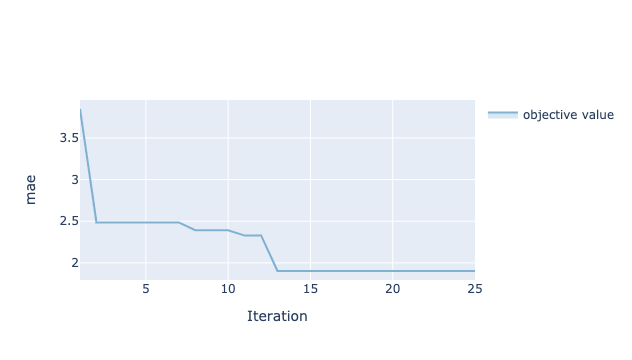

In [15]:
from ax.plot.trace import optimization_trace_single_method

best_objectives = np.array(
    [[trial.objective_mean for trial in exp.trials.values()]]
)
best_objective_plot = optimization_trace_single_method(
    y=np.minimum.accumulate(best_objectives, axis=1), ylabel="mae",
)
render(best_objective_plot)

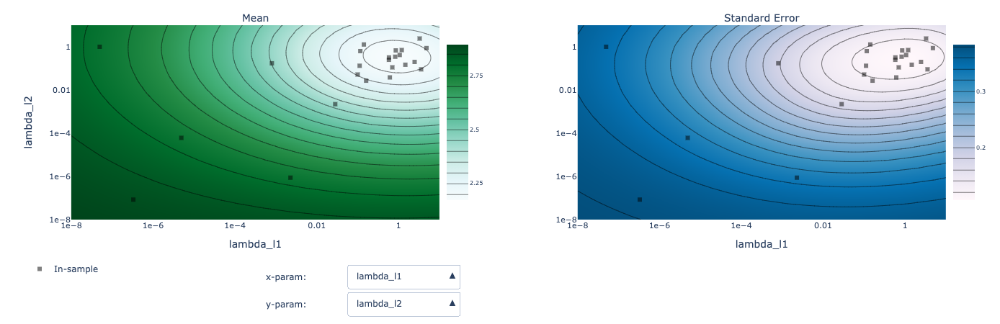

In [16]:
from ax.plot.contour import interact_contour

# 2つのパラメータを軸に取って期待値と標準偏差を表したグラフ
render(interact_contour(model=gpei, metric_name="mae"))

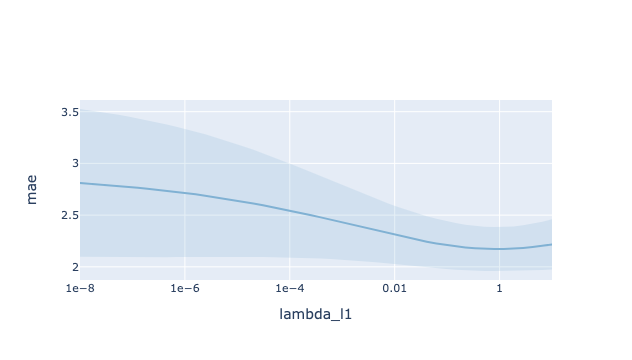

In [17]:
from ax.plot.slice import plot_slice

# パラメータ 1 つ選択してスコアの期待値と標準偏差を表したグラフ
render(plot_slice(gpei, "lambda_l1", "mae"))